In [1]:
import pandas as pd
import numpy as np
from tqdm import tqdm

import warnings
warnings.filterwarnings("ignore")

In [2]:
train = input()
if train.lower()=='yes':
    train=True
else:
    train=False

no


In [3]:
vm = input()
if vm.lower()=='yes':
    vm=True
else:
    vm=False

yes


In [4]:
bdt_J19 = pd.read_csv('df_bdt_eval.csv')
bdt_J19_5M_23 = bdt_J19[(bdt_J19['opt']==23) & (bdt_J19['model']=='5M')]
bdt_J19_5M_0 = bdt_J19[(bdt_J19['opt']==0) & (bdt_J19['model']=='5M')]

In [5]:
if vm:
    path='/mnt/cephfs/ml_data/mc_2021/'
else:
    path=''

data_ideal = pd.read_csv('{}processed_data/ProcessedTrainIdeal/ProcessedTrain_1M.csv.gz'.format(path))
data_ideal = data_ideal[data_ideal['edepR'] < 17.2]

data_real = pd.read_csv('{}processed_data/ProcessedTrainReal/ProcessedTrain_1M.csv.gz'.format(path))
data_real = data_real[data_real['edepR'] < 17.2]

In [6]:
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import plotly.io as pio

corr_matrix = data_ideal.corr()

fig = go.Figure(data=go.Heatmap(
          x = corr_matrix.index,
          y = corr_matrix.columns,
          z = corr_matrix.values,
          type = 'heatmap',
          xgap=0.25,
          ygap=0.25,
          colorscale = 'Inferno',
          name='Real')
)

fig.update_layout(
    width=950,
    height=1200,
    xaxis_nticks=corr_matrix.index.shape[0],
    yaxis_nticks=corr_matrix.index.shape[0],
    font=dict(
        family="Times New Roman",
        size=11,
        color="Black"
    )
)

fig.show()
pio.write_image(fig, 'plots/corr_matrix_ideal.pdf', width=1200, height=1200, scale=1)

In [7]:
corr_matrix = data_real.corr()

fig = go.Figure(data=go.Heatmap(
          x = corr_matrix.index,
          y = corr_matrix.columns,
          z = corr_matrix.values,
          type = 'heatmap',
          xgap=0.25,
          ygap=0.25,
          colorscale = 'Inferno',
          name='Real')
)

fig.update_layout(
    width=950,
    height=1200,
    xaxis_nticks=corr_matrix.index.shape[0],
    yaxis_nticks=corr_matrix.index.shape[0],
    font=dict(
        family="Times New Roman",
        size=11,
        color="Black"
    )
)

fig.show()
pio.write_image(fig, 'plots/corr_matrix_real.pdf', width=1200, height=1200, scale=1)

In [8]:
all_data = [data_ideal, data_real]

In [9]:
N = int(1e6)
X_trains = []
y_trains = []

X_vals = []
y_vals = []

for i in range(len(all_data)):
    X = all_data[i].iloc[:, :-5]
    y = all_data[i].iloc[:, -5]

    X_train = X[:N]
    y_train = y[:N]

    X_val = X[N:]
    y_val = y[N:]
    
    X_trains.append(X_train)
    y_trains.append(y_train)
    
    X_vals.append(X_val)
    y_vals.append(y_val)

In [10]:
from xgboost import XGBRegressor
import pickle
import eli5
import shap
from eli5.sklearn import PermutationImportance

if train:
    for i in tqdm(range(len(all_data))):
        xgbreg = XGBRegressor(
                max_depth=9,
                learning_rate=0.08,
                n_estimators=3000,
                random_state=22,
        )

        xgbreg.fit(X_trains[i], y_trains[i], verbose=False,
                   eval_set=[(X_vals[i], y_vals[i])],
                   early_stopping_rounds=7)

        if i == 0:
            pickle.dump(xgbreg, open("models/xgb_energy_{}.dat".format("ideal"), "wb"))
        elif i == 1:
            pickle.dump(xgbreg, open("models/xgb_energy_{}.dat".format("real"), "wb"))

In [11]:
xgbregs = []
perms = []
for i in range(len(all_data)):
    if i == 0:
        xgbreg = pickle.load(open("models/xgb_energy_{}.dat".format("ideal"), "rb"))
        perm = PermutationImportance(xgbreg, random_state=1).fit(X_vals[i], y_vals[i])
    elif i == 1:
        xgbreg = pickle.load(open("models/xgb_energy_{}.dat".format("real"), "rb"))
        perm = PermutationImportance(xgbreg, random_state=1).fit(X_vals[i], y_vals[i])
        
    xgbregs.append(xgbreg)
    perms.append(perm)

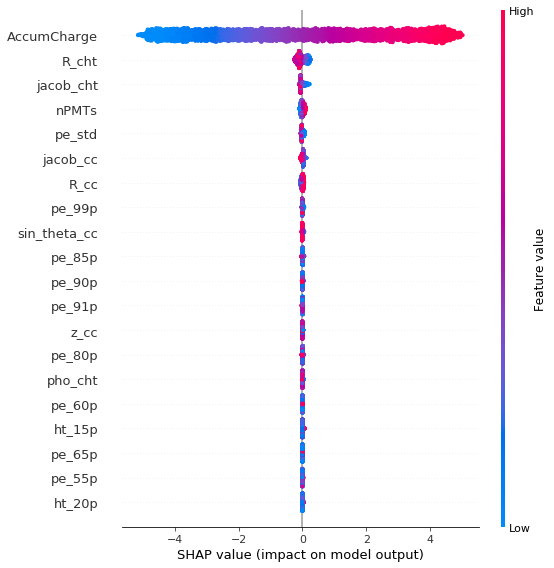

In [12]:
shap_values = shap.TreeExplainer(xgbregs[0]).shap_values(X_vals[0][:5000])
shap.summary_plot(shap_values, X_vals[0][:5000])

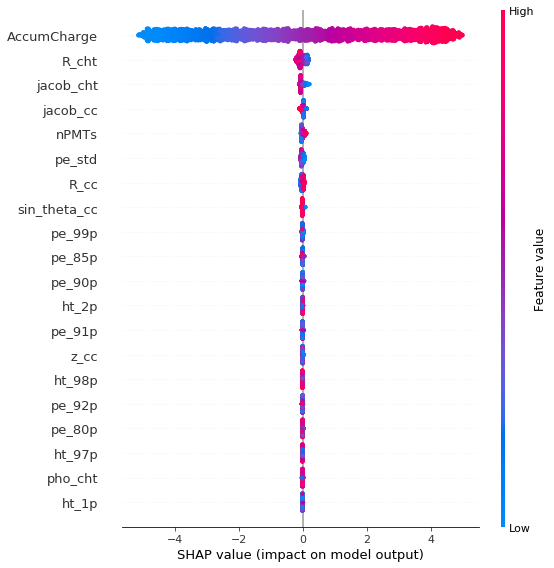

In [13]:
shap_values = shap.TreeExplainer(xgbregs[1]).shap_values(X_vals[1][:5000])
shap.summary_plot(shap_values, X_vals[1][:5000])

In [14]:
eli5.show_weights(perms[0], feature_names=X.columns.tolist(), top=15)
# eli5.show_prediction(xgbregs[0], X_vals[0].iloc[100], show_feature_values=True, feature_names=X.columns.tolist())

Weight,Feature
1.8927 ± 0.0066,AccumCharge
0.0036 ± 0.0000,R_cht
0.0028 ± 0.0000,nPMTs
0.0016 ± 0.0000,pe_std
0.0015 ± 0.0000,jacob_cht
0.0010 ± 0.0000,R_cc
0.0005 ± 0.0000,jacob_cc
0.0003 ± 0.0000,pe_99p
0.0002 ± 0.0000,sin_theta_cc
0.0001 ± 0.0000,pe_85p


In [15]:
eli5.show_weights(perms[1], feature_names=X.columns.tolist(), top=15)

Weight,Feature
1.9284 ± 0.0068,AccumCharge
0.0018 ± 0.0000,nPMTs
0.0017 ± 0.0000,R_cht
0.0017 ± 0.0000,R_cc
0.0016 ± 0.0000,pe_std
0.0014 ± 0.0000,jacob_cht
0.0008 ± 0.0000,jacob_cc
0.0003 ± 0.0000,pe_99p
0.0002 ± 0.0000,sin_theta_cc
0.0001 ± 0.0000,pe_85p


In [16]:
y_true_array = []
y_pred_array = []
for j in range(len(all_data)):
    if j == 0:
        name = 'ProcessedTestIdeal'
        option = 'ideal'
    elif j == 1:
        name = 'ProcessedTestReal'
        option = 'real'
    y_true = []
    y_pred = []
    for i in range(11):
        test = pd.read_csv('{}processed_data/{}/{}MeV.csv.gz'.format(path, name, i))
        test = test[test['edepR'] < 17.2]
        einit = pd.read_csv('{}raw_data/{}/test/targets/e+_{}/einit_test_0.csv'.format(path, option, i))
        for k in range(99):
            einit = einit.append(
                pd.read_csv('{}raw_data/{}/test/targets/e+_{}/einit_test_{}.csv'.format(path, option, i, k))
            )
        einit = einit.reset_index().drop('index', axis=1)
        einit = np.array(einit.iloc[test.index]).reshape(-1) + 0.511
        X_test = test.iloc[:, :-5]
        einit_preds = xgbregs[j].predict(np.array(X_test))

        y_true.append(einit)
        y_pred.append(einit_preds)
    y_true_array.append(y_true)
    y_pred_array.append(y_pred)

In [17]:
import plotly.io as pio
pio.templates.default = 'plotly_dark'

def plot_predicts(y_pred, y_true, title='', size=10000):
    fig = go.Figure()

    for i in range(len(y_pred)):
        fig.add_trace(
            go.Scattergl(
                x=list(range(y_true[i][:size].shape[0])),
                y=y_pred[i][:size],
                mode='markers',
                opacity=0.75,
                marker=dict(
                    size=3,
                    color='rgb(255, {}, {})'.format(255-i*25, 5*i+10)
                ),
                name='{}MeVXGB'.format(i+1)
            )
        )
        fig.add_trace(
            go.Scattergl(
                x=list(range(y_true[i][:size].shape[0])),
                y=y_true[i][:size],
                mode='markers',
                opacity=0.75,
                marker=dict(
                    size=3,
                    color='rgb(15, {}, {})'.format(100-i*5, 25*i+10)
                ),
                name='{}MeV'.format(i+1)
            )
        )

    fig.update_layout(
        title = title,
        showlegend=False,
        yaxis_title="Energy, MeV",
        xaxis_title="x",
        font=dict(
            family="Times New Roman",
            size=16,
            color="White"
        ),
        xaxis = dict(
            showline=True,
            ticks='outside',
            mirror=True,
            linecolor='black',
            showgrid=True,
            gridcolor='grey',
            gridwidth=0.25,
        ),
        yaxis = dict(
            showline=True,
            ticks='outside',
            mirror=True,
            linecolor='black',
            showgrid=True,
            gridcolor='grey',
            gridwidth=0.25,
            zeroline=True,
            zerolinecolor='black',
            zerolinewidth=0.25
            ),
    )

    fig.show()
    pio.write_image(fig, 'plots/plot_predictions_{}_Enit.pdf'.format(title.split(', ')[0]), width=900, height=600)

In [18]:
# plot_predicts(y_pred_array[0], y_true_array[0], title='Ideal, 500k')
plot_predicts(y_pred_array[1], y_true_array[1], title='Real, 1M', size=7500)

In [35]:
diffs = np.array([
    [y_pred_array[j][i] - y_true_array[j][i] for i in range(len(y_pred_array[0]))]
    for j in range(len(y_pred_array))
])

In [36]:
energies = np.array([1.022+i for i in range(11)]).round(5)
energies

array([ 1.022,  2.022,  3.022,  4.022,  5.022,  6.022,  7.022,  8.022,
        9.022, 10.022, 11.022])

In [37]:
names = ['J21 1M Ideal', 'J21 1M Real', 'J19 5M Ideal', 'J19 5M Real']

In [38]:
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from scipy.stats import norm

a_array = []
errors_array = []
for k in range(diffs.shape[0]):
    a = []
    e = []
    for i in range(diffs.shape[1]):
        fig, ax = plt.subplots()
        nbins = 150
        n, bins, patches = ax.hist(diffs[k][i], nbins, density=True, facecolor = 'grey', alpha = 0.5, label='before');
        plt.close(fig)
        centers = (0.5*(bins[1:]+bins[:-1]))
        pars, cov = curve_fit(lambda x, mu, sig : norm.pdf(x, loc=mu, scale=sig), centers, n, p0=[0,1])  
        a.append(pars)
        e.append(cov)
    a_array.append(a)
    errors_array.append(e)

In [42]:
pio.templates.default = 'plotly_white'

from scipy import stats
for k in range(len(all_data)):
#     fig = make_subplots(specs=[[{"secondary_y": True}]])
    fig = go.Figure()

    for i in range(len(diffs[k])): 
        x = np.linspace(diffs[k][i][:25000].min(), diffs[k][i][:25000].max(), 100)
        p = stats.norm.pdf(x, a_array[k][i][0], a_array[k][i][1])

        fig.add_trace(go.Scattergl(x=x,
                     y=p, mode='lines', name='mu={:.3f} +- {:.3f}, sigma={:.3f} +- {:.3f}'.format(
                         a_array[k][i][0], np.sqrt(errors_array[k][i][0][0]),
                         a_array[k][i][1], np.sqrt(errors_array[k][i][1][1])),
                        visible = (i==0)
                    ), )#secondary_y=False)

    for i in range(len(diffs[k])): 
        fig.add_trace(go.Histogram(x=diffs[k][i][:25000], xbins=dict(size=0.01),
                      showlegend=False, histnorm='probability density',
                     visible = (i==0)
                    ), )#secondary_y=True)

    buttons = []
    for N in range(0, len(diffs[k])): 
        buttons.append(
            dict(
                 args=['visible', [False]*N + [True] + [False]*(len(diffs[k])-1-N)],
                     label='Energy =  {} MeV'.format(energies[N]),
                 method='restyle'
            )
        )
        
    fig.update_layout(

        xaxis = dict(
            showline=True,
            ticks='outside',
            mirror=True,
            linecolor='black',
            showgrid=True,
            gridcolor='grey',
            gridwidth=0.25,
        ),

        yaxis = dict(
            showline=True,
            ticks='outside',
            mirror=True,
            linecolor='black',
            tick0=0,
#             dtick=1,
            showgrid=True,
            gridcolor='grey',
            gridwidth=0.25,
            zeroline=True,
            zerolinecolor='black',
            zerolinewidth=0.25
            ),
    )

    fig.update_layout(
        title = '{}'.format(names[k]),
        xaxis_title=r"$$E_{rec} - E_{true}$$",
        showlegend=True,
        updatemenus=list([
            dict(
                x=0.5,
                y=1.2,
                yanchor='top',
                buttons=buttons
            ),
        ]),
        legend=dict(
            orientation="h",
            yanchor="bottom",
            y=1.05,
            xanchor="right",
            x=1
        )
    )
    
#     fig.update_yaxes(type="log", secondary_y=True)

    fig.show()

In [24]:
def plot_results(appr=False):
    
#     y_lin = lambda x: np.sqrt(2.57**2 / x + 0.73**2 + (1.25 / x)**2)
    fig = make_subplots(rows=2, cols=1,
                        shared_xaxes=True,
                        vertical_spacing=0.01,
                        row_width=[0.25, 0.75]
    )

    for k in range(diffs.shape[0]):
        fig.add_trace(
            go.Scatter(
                x=energies,
                y=res[k],
                mode='markers',
                marker=dict(
                    color=colors[k],
                    symbol=symbols[k]
                ),
                showlegend=True,
                error_y=dict(
                    type='data',
                    width=10,
                    array=error_sigma[k],
                    visible=True
                ),
                name=names[k]
            ), row=1, col=1
        )

        fig.add_trace(
            go.Scatter(
                x=energies,
                y=bias[k],
                mode='markers',
                showlegend=False,
                marker=dict(
                    color=colors[k],
                    symbol=symbols[k]
                ),
                error_y=dict(
                        type='data',
                        width=10,
                        array=error_mu[k],
                        visible=True
                ),
                name=names[k]
            ), row=2, col=1
        )

    if appr:
        for k in range(len(names)):
            fig.add_trace(
                go.Scatter(
                    x=x_lin,
                    y=func(x_lin, a[k], b[k], c[k]),
                    mode='lines',
                    line=dict(
                    ),
                    opacity=0.5,
                    showlegend=False,
                    name=names[k],
                    marker=dict(
                        color=colors[k]
                    )
                ), row=1, col=1
            )

    trace = lambda x, y, error_y, col, name, sym, leg=True: go.Scatter(
                        x=x,
                        y=100*y,
                        mode='markers',
                        name=name,
                        showlegend=leg,
                        marker=dict(
                            color=col,
                            symbol=sym
                        ),
                        error_y=dict(
                            type='data',
                            width=10,
                            array=100*error_y
                        )
    )

    fig.add_trace(
        trace(
            bdt_J19_5M_0.energy+1.022,
            bdt_J19_5M_0.res,
            bdt_J19_5M_0.res_err,
            'blue',
            'J19 5M Ideal',
            'square',
        ),
        row=1, col=1
    )

    fig.add_trace(
        trace(
            bdt_J19_5M_23.energy+1.022,
            bdt_J19_5M_23.res,
            bdt_J19_5M_23.res_err,
            'green',
            'J19 5M Real',
            'cross-open-dot',
        ),
        row=1, col=1
    )

    fig.add_trace(
        trace(
            bdt_J19_5M_0.energy+1.022,
            bdt_J19_5M_0.bias,
            bdt_J19_5M_0.bias_err,
            'blue',
            'J19 5M Ideal',
            'square',
            False
        ),
        row=2, col=1
    )

    fig.add_trace(
        trace(
            bdt_J19_5M_23.energy+1.022,
            bdt_J19_5M_23.bias,
            bdt_J19_5M_23.bias_err,
            'green',
            'J19 5M Real',
            'cross-open-dot',
            False
        ),
        row=2, col=1
    )

#     fig.add_trace(
#         go.Scatter(
#             x=x_lin,
#             y=y_lin(x_lin),
#             mode='lines',
#             line=dict(
#                dash='dash',
#                color='black'
#             ),
#             showlegend=False,
#             opacity=0.5,
#             name='Ideal non-unifor. correction'
#         ), row=1, col=1
#     )

    xaxis = dict(
        showline=True,
        ticks='outside',
        mirror=True,
        tick0=1,
        dtick=1,
        linecolor='black',
        showgrid=True,
        gridcolor='grey',
        gridwidth=0.25,
    )

    yaxis = lambda range: dict(
        showline=True,
        ticks='outside',
        mirror=True,
        linecolor='black',
        range=range,
        showgrid=True,
        gridcolor='grey',
        gridwidth=0.25,
        zeroline=True,
        zerolinecolor='black',
        zerolinewidth=0.25
    )

    fig.update_layout(
        xaxis2_title="Visible energy, MeV",
        yaxis1_title="Resolution, %",
        yaxis2_title="Bias, %",

        xaxis1 = xaxis,
        xaxis2 = xaxis,
        yaxis1 = yaxis([0, 3.5]),
        yaxis2 = yaxis([-0.25, 0.25]),

        showlegend=True,
        font=dict(
                family="Times New Roman",
                size=18,
        ),
        legend=dict(
            x=0.75,
            y=0.99,
            title_font_family="Times New Roman",
            font=dict(
                family="Times New Roman",
                size=18,
                color="black"
            ),
            bordercolor="Black",
            borderwidth=2
        )
    )

    fig.show()
    if appr:
        pio.write_image(fig, 'plots/appr_results_Einit.pdf', width=900, height=600, scale=1)
    else:
        pio.write_image(fig, 'plots/results_Einit.pdf', width=900, height=600, scale=1)

In [25]:
colors = ['red', 'darkviolet', 'blue', 'green']
symbols = ['hexagon-open', 'star-square']

In [26]:
error_sigma = []
for k in range(diffs.shape[0]):
    error = [100 * np.sqrt(errors_array[k][i][1][1]) / energies[i] for i in range(len(energies))]
    error_sigma.append(error)
    
error_mu = []
for k in range(diffs.shape[0]):
    error = [100 * np.sqrt(errors_array[k][i][0][0]) / energies[i] for i in range(len(energies))]
    error_mu.append(error)

In [27]:
res = []
bias = []
for k in range(diffs.shape[0]):
    sigma = [100 * a_array[k][i][1] / energies[i] for i in range(len(energies))]
    mu = [100 * a_array[k][i][0] / energies[i] for i in range(len(energies))]
    res.append(sigma)
    bias.append(mu)
    
plot_results()

In [28]:
def a(x, a):
    return np.sqrt((a/x**0.5)**2)


def b(x, b):
    b_list = []
    b_list.append(np.sqrt(b**2))
    return b_list*len(x)


def c(x, c):
    return np.sqrt((c/x)**2)


def func(x, a, b, c):
    return np.sqrt((a/x**0.5)**2 + b**2 + (c/x)**2) 


def approximated(x, y, yerr):
    popt, pcov = curve_fit(func, x, y, sigma=yerr, maxfev=10**9, bounds=([0, 0, 0], [5, 5, 5]))
    a, b, c = popt
    perr = np.sqrt(abs(pcov.diagonal()))

    return func(x, a, b, c), popt, perr

In [29]:
y_approximated_array = []
coefs_array = []
errors_array = []
for i in range(diffs.shape[0]):
    y_approximated, coefs, errors = approximated(
        energies[1:10], res[i][1:10], error_sigma[i][1:10])
    y_approximated_array.append(y_approximated)
    coefs_array.append(coefs)
    errors_array.append(errors)
    
y_approximated, coefs, errors = approximated(
    bdt_J19_5M_0.energy+1.022, 100*bdt_J19_5M_0.res, 100*bdt_J19_5M_0.res_err)
y_approximated_array.append(y_approximated)
coefs_array.append(coefs)
errors_array.append(errors)

y_approximated, coefs, errors = approximated(
    bdt_J19_5M_23.energy+1.022, 100*bdt_J19_5M_23.res, 100*bdt_J19_5M_23.res_err)
y_approximated_array.append(y_approximated)
coefs_array.append(coefs)
errors_array.append(errors)

In [30]:
reindex = [0, 3, 1, 4, 2, 5]
coefs_df = pd.DataFrame(
    np.hstack((coefs_array, errors_array))
)[reindex]
coefs_df.columns = ['a', r'$\Delta a$', 'b', r'$\Delta b$', 'c', r'$\Delta c$']

a = np.array(coefs_array).T[0]
b = np.array(coefs_array).T[1]
c = np.array(coefs_array).T[2]

In [31]:
x_lin = np.linspace(0.8, 11.5, 1000)
plot_results(appr=True)

**The JUNO collaboration., Abusleme, A., Adam, T. et al. Calibration strategy of the JUNO experiment. J. High Energ. Phys. 2021, 4 (2021). https://doi.org/10.1007/JHEP03(2021)004**

It was found, numerically, that the JUNO baseline requirement to determine the MO to 3 – 4 $\sigma$ significance could be translated into a convenient requirement on an effective resolution $\tilde{a}$ as:

$$\tilde{a} \equiv \sqrt{(a)^2 + (1.6 \times b)^2 + \left(\frac{c}{1.6}\right)^2} \leq 3\%$$

Let's calculate the variance as follows:

$$\Delta \tilde{a} = \sqrt{\left(\frac{\partial \tilde{a}}{\partial a} \Delta a \right)^2 + \left(\frac{\partial \tilde{a}}{\partial b} \Delta b \right)^2 + \left(\frac{\partial \tilde{a}}{\partial c} \Delta c \right)^2}$$

Then:
$$\Delta \tilde{a} = \frac{\sqrt{\left(a\Delta a\right)^2 + \left(2.56\times b\Delta b\right)^2 + \left(\frac{c\Delta c}{2.56}\right)^2}}{\tilde{a}}$$

In [32]:
coefs_df = coefs_df.round(3)
coefs_df.index = names
coefs_df[r'$\tilde{a}$'] = (coefs_df['a']**2 + (1.6 * coefs_df['b'])**2 + (coefs_df['c'] / 1.6)**2)**0.5 
coefs_df[r'$\Delta \tilde{a}$'] = np.sqrt( (coefs_df['a']*coefs_df[r'$\Delta a$'])**2 + \
                                           (2.56*coefs_df['b']*coefs_df[r'$\Delta b$'])**2 + \
                                           (coefs_df['c']*coefs_df[r'$\Delta c$'] / 2.56)**2) / coefs_df[r'$\tilde{a}$']

coefs_df

,a,$\Delta a$,b,$\Delta b$,c,$\Delta c$,$\tilde{a}$,$\Delta \tilde{a}$
J21 1M Ideal,2.596,0.057,0.788,0.039,0.000,0.000,2.885972,0.058069
J21 1M Real,2.749,0.044,0.739,0.033,0.000,0.000,2.992502,0.045486
J19 5M Ideal,2.500,0.105,0.658,0.046,0.406,0.927,2.724477,0.114034
J19 5M Real,2.430,0.084,0.699,0.034,1.533,0.195,2.841430,0.085486
